# Setup

Import libraries needed to perform the analysis.

- **Random**: Gives access to the Python's random number generator module.
- **Math**: Gives access to the Python's math module.
- **Numpy**: Fundamental package for scientific computing with Python.
- **Pandas**: High-performance, easy-to-use data structures and data analysis tools for Python.
- **Matplotlib**: Python 2D data plotting library.

In [2]:
import random
import math
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

Set figure size in plots generated by matplotlib:

In [3]:
plt.rcParams['figure.figsize'] = (30, 10)

Simulation parameters are set first, these are as follows:

- **p_winning**: Probability of winning.
- **init_capital**: Initial capital to start the simulation.
- **ruin_capital**: Capital that if reached by the simulation then it's interpreted as reaching ruin.
- **run_times**: Simulation is runs this many times.
- **trials**: Trials to run on each simulation step.
- **mdd_level**: Desired Maximum Drawdown level to accent in plots. Value should be in the range `[-1, 0]`.

Percentiles to accent in plots are also configured here.

In [4]:
p_winning = 0.52

init_capital = 10000
ruin_capital = 0
run_times = 100
trials = 1000
mdd_level = -0.30  # Desired MDD : Negative [-1, 0] : (appears as h line in CDF Maximum Drawdown)

# Control vline position on CDF graphs
percentile_avg = 0.5
percentile_below = 0.05
percentile_above = 0.95

The `play` function takes a probability value `p` and runs a random simulation that returns `True` with that given probability and `False` with `1 - p` probability. This function simulates a random outcome with a known probability.

In [5]:
def successful_trade(p=p_winning):
    roll = random.randint(1, 100)

    threshold = p * 100
    
    # User win when rolling [0, p]
    if roll <= threshold:
        return True
    
    return False

# Computing strategies
## Fixed position sizing

In this position sizing method the player always bet the same amount.

In [206]:
def fixed_strategy(funds, pos_size, trials):
    current_funds = funds
    
    trades = np.array([], dtype=int)
    funds = np.array([], dtype=int)
    drawdown = np.array([], dtype=float)
    
    for single_trade in range(trials):
        if current_funds > 0:
            if successful_trade():
                current_funds += pos_size
            else:
                current_funds -= pos_size
                
        trades = np.append(trades, single_trade)  # Add trade to samples

        # Add funds to samples
        if current_funds < 0:
            current_funds = 0
        
        funds = np.append(funds, current_funds)

        # Add drawdown to samples
        if current_funds > 0:
            dd = (current_funds - np.amax(funds)) / np.amax(funds)
        else:
            dd = -1

        drawdown = np.append(drawdown, np.amin([0, dd]))
    
    plt.figure(0)
    plt.plot(trades, funds)
    plt.xlabel('Trial')
    plt.ylabel('Capital')
    #plt.savefig('strategy-fixed-capital.png', bbox_inches='tight')
    
    plt.figure(1)
    plt.plot(trades, drawdown)
    plt.xlabel('Trial')
    plt.ylabel('Drawdown')
    #plt.savefig('strategy-fixed-drawdown.png', bbox_inches='tight')
    
    return (current_funds, min(drawdown))

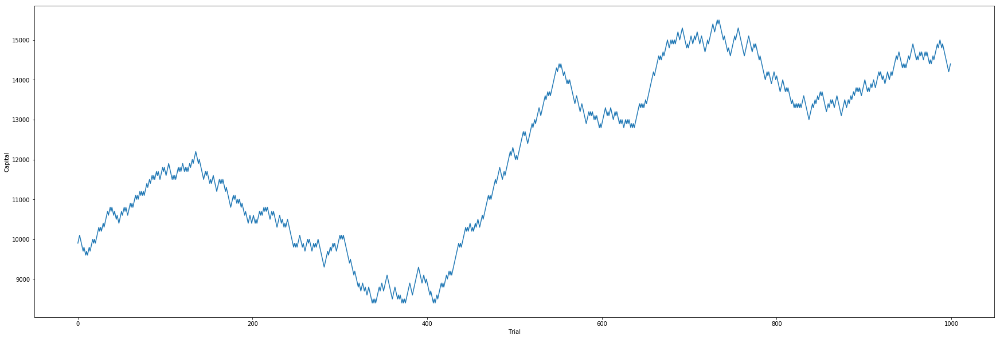

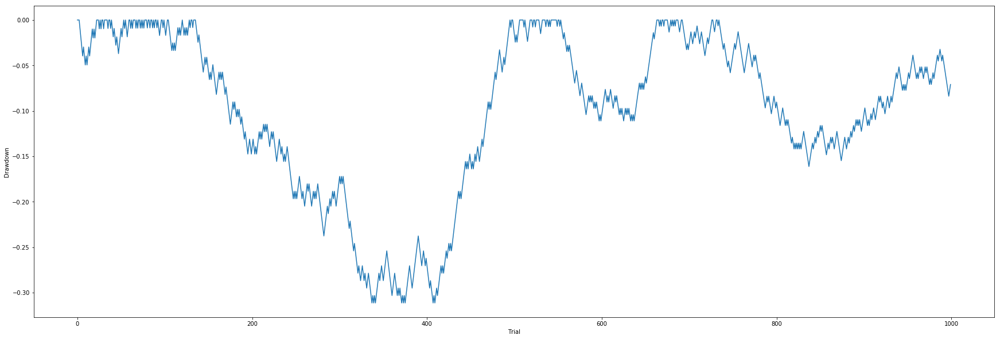

In [11]:
fixed_strategy(init_capital, 100, trials)
plt.show()

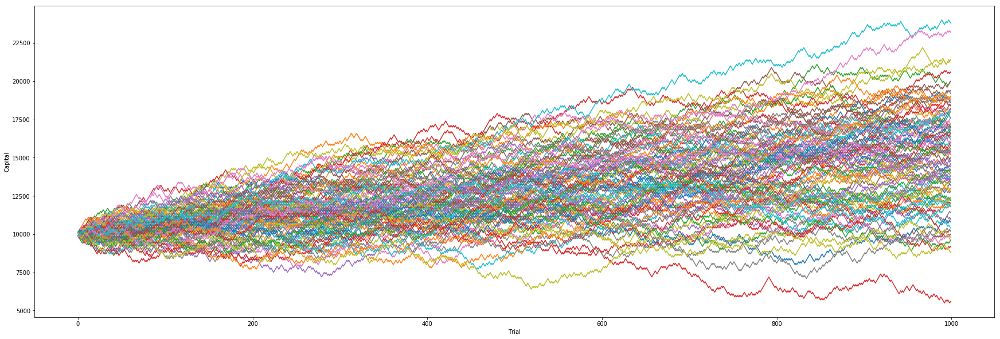

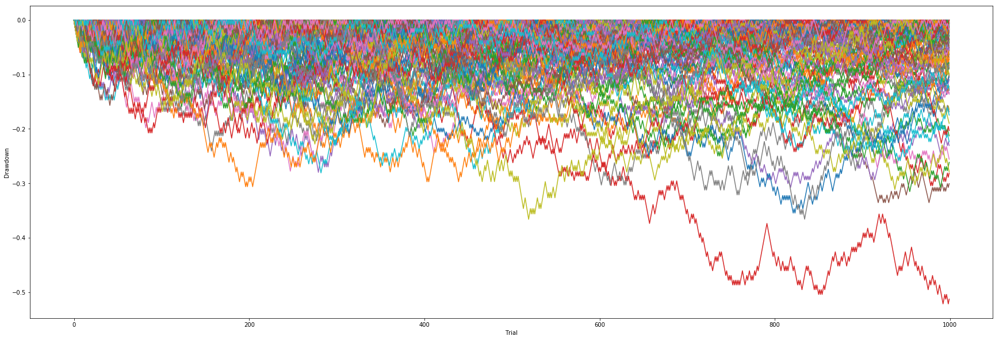

In [207]:
balances = np.array([], dtype=int)
drawdowns = np.array([], dtype=float)

for _ in range(run_times):
    run_result, run_dd = fixed_strategy(init_capital, 100, trials)
    balances = np.append(balances, run_result)
    drawdowns = np.append(drawdowns, run_dd)

plt.savefig('montecarlo-fixed.png', bbox_inches='tight')
plt.show()

In [208]:
fixed_results = pd.DataFrame({'balance': balances, 'drawdown': drawdowns})
percent_unit = 1 / len(fixed_results)

fixed_results['cump_balance'] = percent_unit
fixed_results['cump_dd'] = percent_unit

fixed_results['cump_balance'] = fixed_results.sort_values('balance').cump_balance.cumsum()
fixed_results['cump_dd'] = fixed_results.sort_values('drawdown').cump_dd.cumsum()

In [209]:
fixed_results.describe()

,balance,drawdown,cump_balance,cump_dd
count,100.000000,100.000000,100.000000,100.000000
mean,15176.000000,-0.189464,0.505000,0.505000
std,3361.250369,0.079299,0.290115,0.290115
min,5600.000000,-0.521739,0.010000,0.010000
25%,12800.000000,-0.234296,0.257500,0.257500
50%,15400.000000,-0.170996,0.505000,0.505000
75%,17300.000000,-0.130435,0.752500,0.752500
max,23800.000000,-0.060403,1.000000,1.000000


In [210]:
balance_results = fixed_results.sort_values('balance')
drawdown_results = fixed_results.sort_values('drawdown')

### CDF Ending Balance

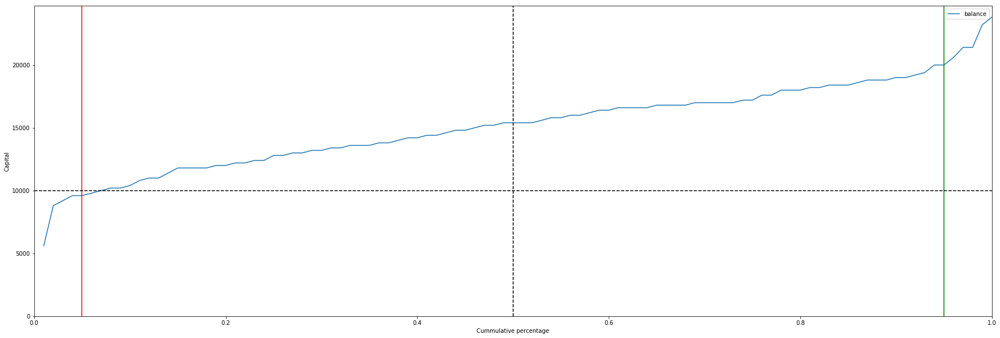

In [211]:
ax = balance_results.plot(x='cump_balance', y='balance')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(init_capital, color='black', linestyle='--')
plt.xlabel('Cummulative percentage')
plt.ylabel('Capital')
plt.xlim(0, 1)
plt.ylim(bottom=0)
plt.show()

In [212]:
percentile_5th = balance_results[balance_results.cump_balance <= percentile_below].tail(1)
percentile_95th = balance_results[balance_results.cump_balance >= percentile_above].head(1)
percentile_50th = balance_results.iloc[int(len(balance_results) / 2)]

threshold = balance_results[balance_results.balance >= init_capital].head(1)
ruin_threshold = balance_results[balance_results.balance <= ruin_capital].tail(1)

In [213]:
p5th_delta = (percentile_5th.balance.values[0] - init_capital) / init_capital
p95th_delta = (percentile_95th.balance.values[0] - init_capital) / init_capital
p50th_delta = (percentile_50th.balance - init_capital) / init_capital

In [214]:
print('On average return is expected to end at {:.2f}% or less.\n'.format(p50th_delta * 100))
print("There's a 5% chance that return ends at {:.2f}% or less.\n".format(p5th_delta * 100))
print("There's a 95% chance that return ends at {:.2f}% or less.\n".format(p95th_delta * 100))

print('{:.2f}% of simulations had capital lost.'.format(threshold.cump_balance.values[0] * 100))

if ruin_threshold.empty:
    print('  None of the simulations lost everything')
else:
    print('{:.2f}% of simulations lost everything.'.format(ruin_threshold.cump_balance.values[0] * 100))

On average return is expected to end at 54.00% or less.

There's a 5% chance that return ends at -4.00% or less.

There's a 95% chance that return ends at 100.00% or less.

7.00% of simulations had capital lost.
  None of the simulations lost everything


### CDF Maximum Drawdown

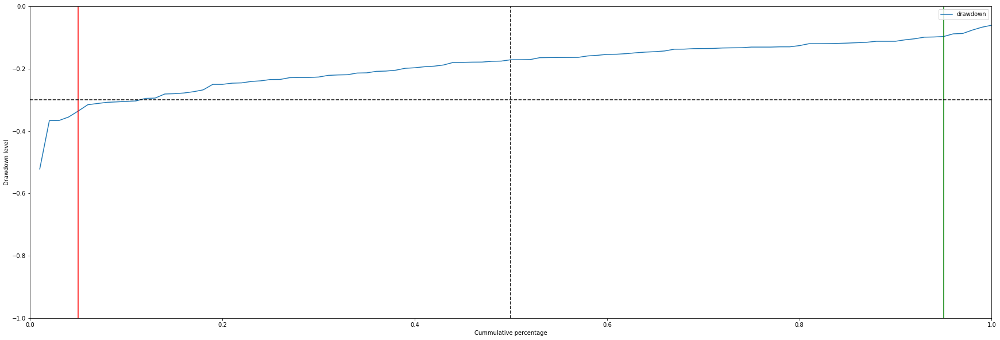

In [215]:
ax = drawdown_results.plot(x='cump_dd', y='drawdown')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(mdd_level, color='black', linestyle='--')
plt.xlabel('Cummulative percentage')
plt.ylabel('Drawdown level')
plt.xlim(0, 1)
plt.ylim(-1, 0)
plt.show()

In [216]:
percentile_5th = drawdown_results[drawdown_results.cump_dd <= percentile_below].tail(1)
percentile_95th = drawdown_results[drawdown_results.cump_dd >= percentile_above].head(1)
percentile_50th = drawdown_results.iloc[int(len(drawdown_results) / 2)]

threshold = drawdown_results[drawdown_results.drawdown <= mdd_level].tail(1)

In [217]:
print('On average MDD is expected to be {:.2f}% or greater.\n'.format(percentile_50th.drawdown * 100))
print("There's a 5% chance for MDD to be {:.2f}% or greater.\n".format(percentile_5th.drawdown.values[0] * 100))
print("There's a 95% chance for MDD to be {:.2f}% or greater.\n".format(percentile_95th.drawdown.values[0] * 100))

print('{:.2f}% of simulations had greater MDD than {:.2f}%.'.format(threshold.cump_dd.values[0] * 100, mdd_level * 100))

On average MDD is expected to be -17.09% or greater.

There's a 5% chance for MDD to be -33.57% or greater.

There's a 95% chance for MDD to be -9.66% or greater.

11.00% of simulations had greater MDD than -30.00%.


## Fixed percent position sizing

In each roll the player bets a fixed percentage of his current funds, in this case 2% is analyzed.

In [218]:
def percent_strategy(funds, pos_percentage, trials):
    current_funds = funds
    
    trades = np.array([])
    funds = np.array([])
    drawdown = np.array([], dtype=float)
    
    for single_trade in range(trials):
        if current_funds > 0:
            current_size = current_funds * pos_percentage

            if successful_trade():
                current_funds += current_size
            else:
                current_funds -= current_size

        trades = np.append(trades, single_trade)
        
        # Funds to samples
        if current_funds < 0:
            current_funds = 0

        funds = np.append(funds, current_funds)
        
        # Drawdown to samples
        if current_funds > 0:
            dd = (current_funds - np.amax(funds)) / np.amax(funds)
        else:
            dd = -1

        drawdown = np.append(drawdown, np.amin([0, dd]))
            
    plt.figure(0)
    plt.plot(trades, funds)
    plt.xlabel('Trial')
    plt.ylabel('Capital')
    #plt.savefig('strategy-percent-capital.png', bbox_inches='tight')
    
    plt.figure(1)
    plt.plot(trades, drawdown)
    plt.xlabel('Trial')
    plt.ylabel('Drawdown')
    #plt.savefig('strategy-percent-drawdown.png', bbox_inches='tight')
    
    return (current_funds, min(drawdown))

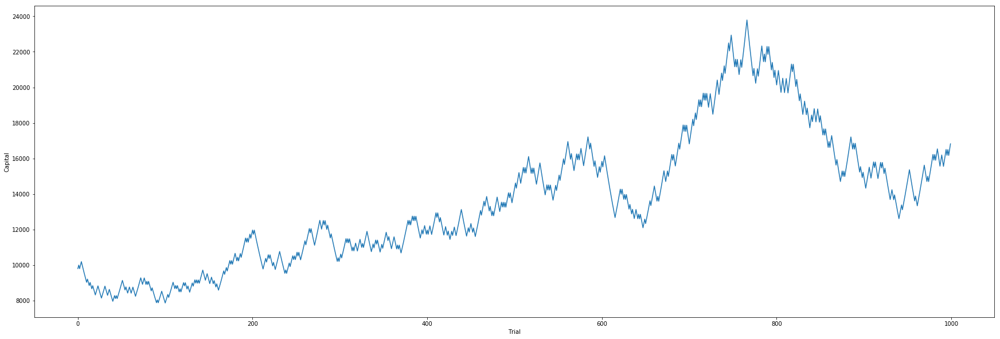

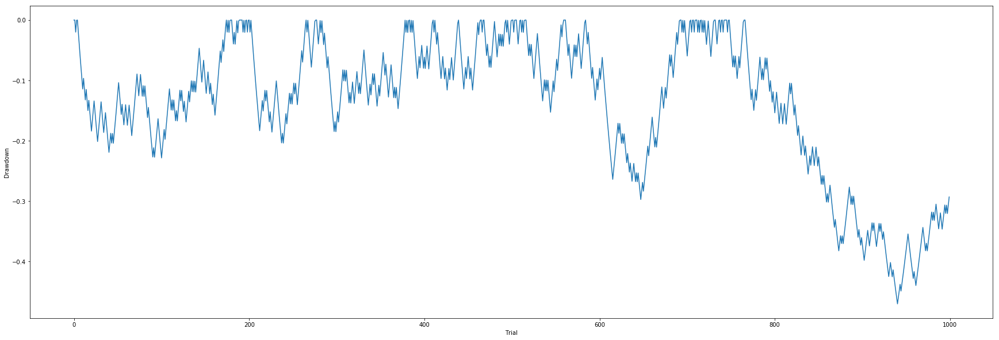

In [219]:
percent_strategy(init_capital, 0.02, trials)
plt.show()

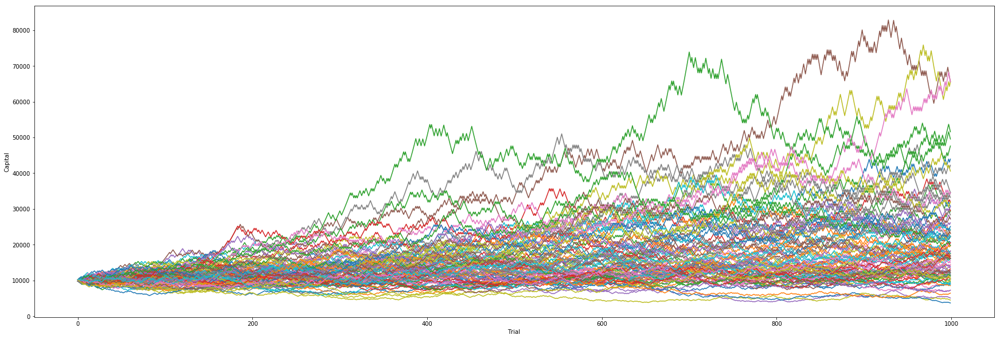

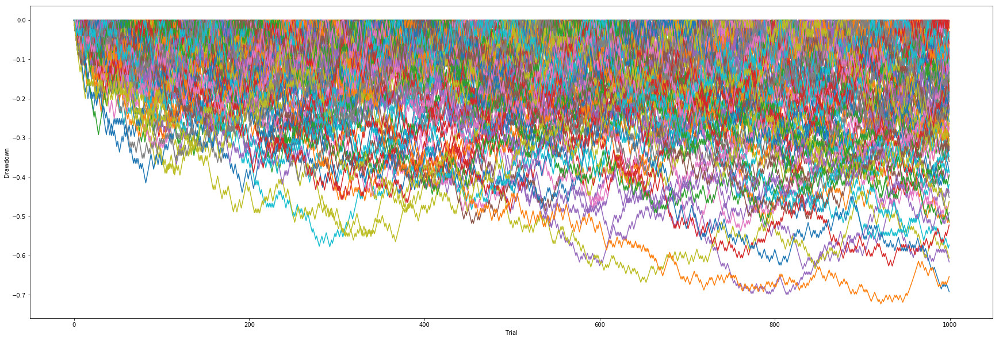

In [220]:
balances = np.array([], dtype=int)
drawdowns = np.array([], dtype=float)

for _ in range(run_times):
    run_result, run_dd = percent_strategy(10000, 0.02, trials)
    balances = np.append(balances, run_result)
    drawdowns = np.append(drawdowns, run_dd)
    
plt.show()

In [221]:
percent_results = pd.DataFrame({'balance': balances, 'drawdown': drawdowns})
percent_unit = 1 / len(percent_results)

percent_results['cump_balance'] = percent_unit
percent_results['cump_dd'] = percent_unit

percent_results['cump_balance'] = percent_results.sort_values('balance').cump_balance.cumsum()
percent_results['cump_dd'] = percent_results.sort_values('drawdown').cump_dd.cumsum()

In [222]:
percent_results.describe()

,balance,drawdown,cump_balance,cump_dd
count,100.000000,100.000000,100.000000,100.000000
mean,21087.400747,-0.415273,0.505000,0.505000
std,12739.528711,0.112740,0.290115,0.290115
min,3678.254761,-0.723344,0.010000,0.010000
25%,12214.190462,-0.484045,0.257500,0.257500
50%,17507.799021,-0.410731,0.505000,0.505000
75%,25351.726215,-0.340879,0.752500,0.752500
max,65550.607784,-0.203104,1.000000,1.000000


In [223]:
balance_results = percent_results.sort_values('balance')
drawdown_results = percent_results.sort_values('drawdown')

### CDF Ending balance

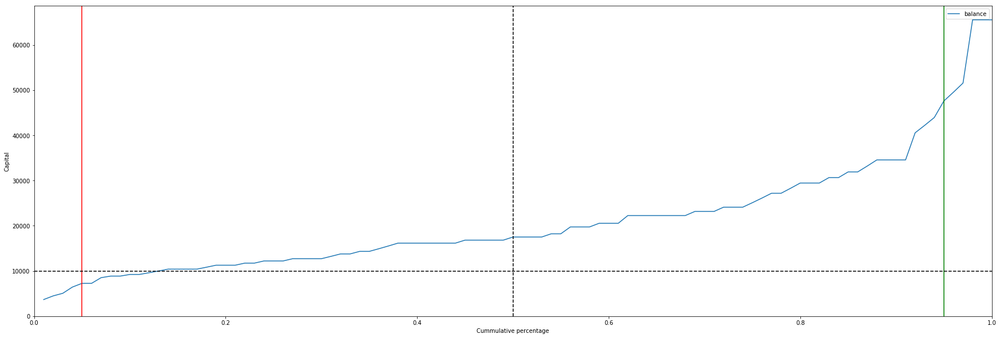

In [224]:
ax = balance_results.plot(x='cump_balance', y='balance')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(init_capital, color='black', linestyle='--')
plt.xlabel('Cummulative percentage')
plt.ylabel('Capital')
plt.xlim(0, 1)
plt.ylim(bottom=0)
plt.show()

In [225]:
percentile_5th = balance_results[balance_results.cump_balance <= percentile_below].tail(1)
percentile_95th = balance_results[balance_results.cump_balance >= percentile_above].head(1)
percentile_50th = balance_results.iloc[int(len(balance_results) / 2)]

threshold = balance_results[balance_results.balance >= init_capital].head(1)
ruin_threshold = balance_results[balance_results.balance <= ruin_capital].tail(1)

In [226]:
p5th_delta = (percentile_5th.balance.values[0] - init_capital) / init_capital
p95th_delta = (percentile_95th.balance.values[0] - init_capital) / init_capital
p50th_delta = (percentile_50th.balance - init_capital) / init_capital

In [227]:
print('On average return is expected to end at {:.2f}% or less.\n'.format(p50th_delta * 100))
print("There's a 5% chance that return ends at {:.2f}% or less.\n".format(p5th_delta * 100))
print("There's a 95% chance that return ends at {:.2f}% or less.\n".format(p95th_delta * 100))

print('{:.2f}% of simulations had capital lost.'.format(threshold.cump_balance.values[0] * 100))

if ruin_threshold.empty:
    print('  None of the simulations lost everything')
else:
    print('{:.2f}% of simulations lost everything.'.format(ruin_threshold.cump_balance.values[0] * 100))

On average return is expected to end at 75.08% or less.

There's a 5% chance that return ends at -27.39% or less.

There's a 95% chance that return ends at 375.97% or less.

14.00% of simulations had capital lost.
  None of the simulations lost everything


### CDF Maximum Drawdown

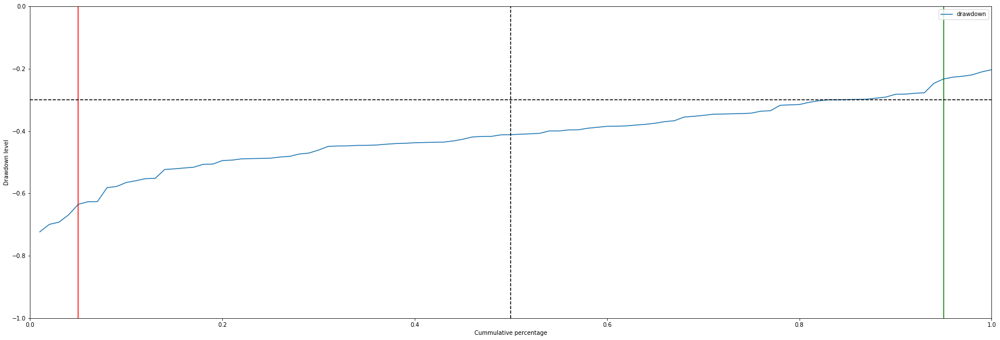

In [228]:
ax = drawdown_results.plot(x='cump_dd', y='drawdown')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(mdd_level, color='black', linestyle='--')
plt.xlabel('Cummulative percentage')
plt.ylabel('Drawdown level')
plt.xlim(0, 1)
plt.ylim(-1, 0)
plt.show()

In [229]:
percentile_5th = drawdown_results[drawdown_results.cump_dd <= percentile_below].tail(1)
percentile_95th = drawdown_results[drawdown_results.cump_dd >= percentile_above].head(1)
percentile_50th = drawdown_results.iloc[int(len(drawdown_results) / 2)]

threshold = drawdown_results[drawdown_results.drawdown <= mdd_level].tail(1)

In [230]:
print('On average MDD is expected to be {:.2f}% or greater.\n'.format(percentile_50th.drawdown * 100))
print("There's a 5% chance for MDD to be {:.2f}% or greater.\n".format(percentile_5th.drawdown.values[0] * 100))
print("There's a 95% chance for MDD to be {:.2f}% or greater.\n".format(percentile_95th.drawdown.values[0] * 100))

print('{:.2f}% of simulations had greater MDD than {:.2f}%.'.format(threshold.cump_dd.values[0] * 100, mdd_level * 100))

On average MDD is expected to be -41.00% or greater.

There's a 5% chance for MDD to be -63.50% or greater.

There's a 95% chance for MDD to be -23.28% or greater.

82.00% of simulations had greater MDD than -30.00%.


## Martingale position sizing

In the martingale strategy the bet size is doubled after each loss, after a win occurs the bet size returns to the initial betting size.

In [231]:
def martingale_strategy(funds, pos_size, trials):
    current_funds = funds
    current_size = pos_size
    
    trades = np.array([], dtype=int)
    funds = np.array([], dtype=int)
    drawdown = np.array([], dtype=float)
    
    for single_trade in range(trials):
        if current_funds > 0:
            if successful_trade():
                current_funds += current_size
                current_size = pos_size
            else:
                current_funds -= current_size
                current_size *= 2
                
        trades = np.append(trades, single_trade)

        # Funds to samples
        if current_funds < 0:
            current_funds = 0

        funds = np.append(funds, current_funds)

        # Drawdown to samples
        if current_funds > 0:
            dd = (current_funds - np.amax(funds)) / np.amax(funds)
        else:
            dd = -1

        drawdown = np.append(drawdown, np.amin([0, dd]))
                
    plt.figure(0)
    plt.plot(trades, funds)
    plt.xlabel('Trial')
    plt.ylabel('Capital')
    #plt.savefig('strategy-martingale-capital.png', bbox_inches='tight')
    
    plt.figure(1)
    plt.plot(trades, drawdown)
    plt.xlabel('Trial')
    plt.ylabel('Drawdown')
    #plt.savefig('strategy-martingale-drawdown.png', bbox_inches='tight')
    
    return (current_funds, min(drawdown))

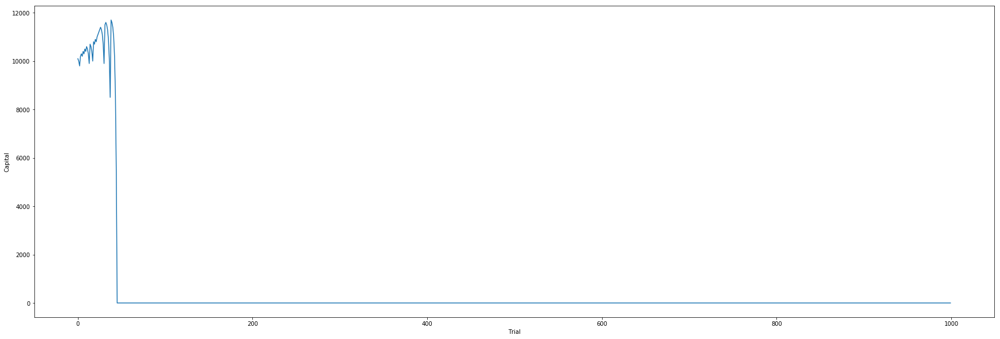

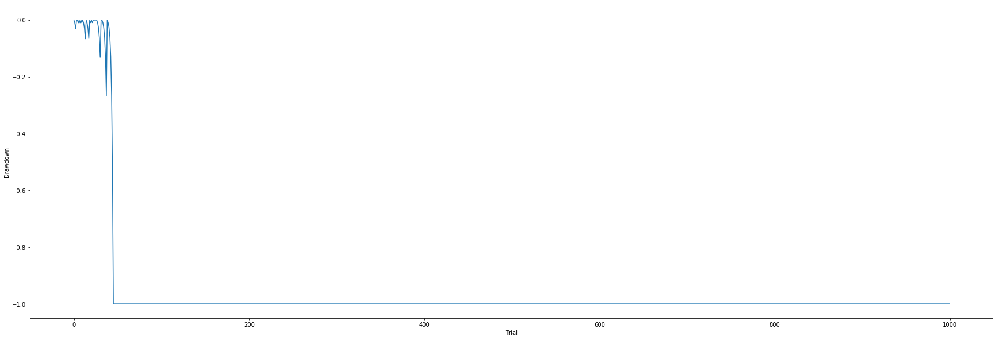

In [232]:
# Single outcome using martingale
martingale_strategy(init_capital, 100, trials)
plt.show()

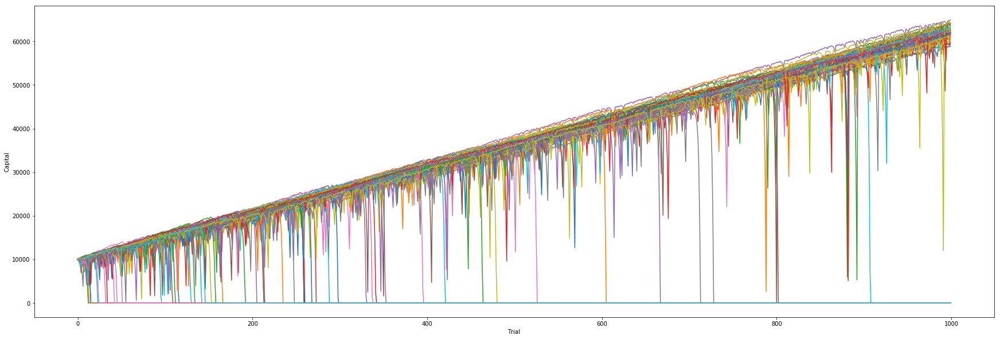

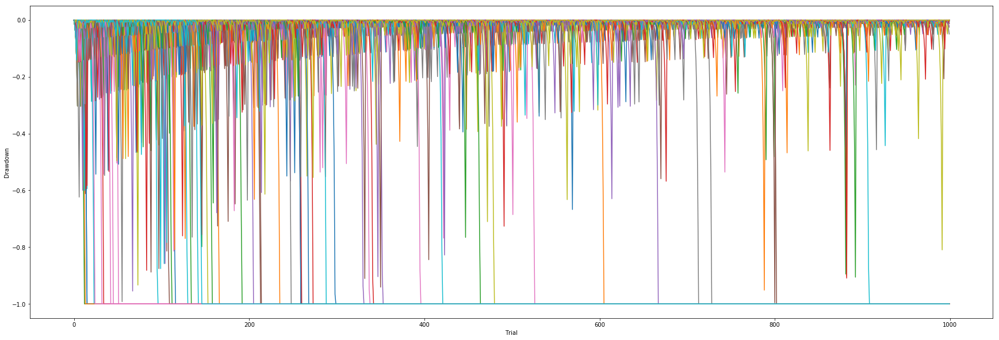

In [233]:
balances = np.array([], dtype=int)
drawdowns = np.array([], dtype=float)

for _ in range(run_times):
    run_result, run_dd = martingale_strategy(init_capital, 100, trials)
    balances = np.append(balances, run_result)
    drawdowns = np.append(drawdowns, run_dd)

plt.show()

In [234]:
martingale_results = pd.DataFrame({'balance': balances, 'drawdown': drawdowns})
percent_unit = 1 / len(martingale_results)

martingale_results['cump_balance'] = percent_unit
martingale_results['cump_dd'] = percent_unit

martingale_results['cump_balance'] = martingale_results.sort_values('balance').cump_balance.cumsum()
martingale_results['cump_dd'] = martingale_results.sort_values('drawdown').cump_dd.cumsum()

In [235]:
martingale_results.describe()

,balance,drawdown,cump_balance,cump_dd
count,100.000000,100.000000,100.000000,100.000000
mean,31001.000000,-0.816039,0.505000,0.505000
std,31172.668341,0.245444,0.290115,0.290115
min,0.000000,-1.000000,0.010000,0.010000
25%,0.000000,-1.000000,0.257500,0.257500
50%,29400.000000,-0.998051,0.505000,0.505000
75%,61925.000000,-0.632526,0.752500,0.752500
max,64900.000000,-0.140625,1.000000,1.000000


In [236]:
balance_results = martingale_results.sort_values('balance')
drawdown_results = martingale_results.sort_values('drawdown')

### CDF Ending Balance

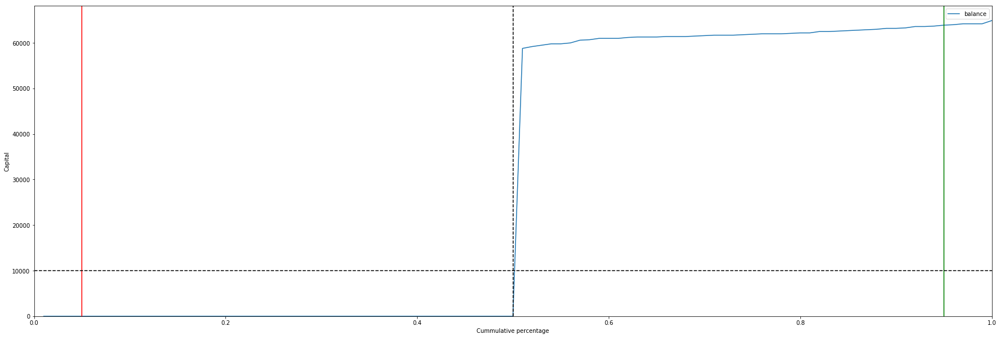

In [237]:
ax = balance_results.plot(x='cump_balance', y='balance')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(init_capital, color='black', linestyle='--')
plt.xlabel('Cummulative percentage')
plt.ylabel('Capital')
plt.xlim(0, 1)
plt.ylim(bottom=0)
plt.show()

In [238]:
percentile_5th = balance_results[balance_results.cump_balance <= percentile_below].tail(1)
percentile_95th = balance_results[balance_results.cump_balance >= percentile_above].head(1)
percentile_50th = balance_results.iloc[int(len(balance_results) / 2)]

threshold = balance_results[balance_results.balance >= init_capital].head(1)
ruin_threshold = balance_results[balance_results.balance <= ruin_capital].tail(1)

In [239]:
p5th_delta = (percentile_5th.balance.values[0] - init_capital) / init_capital
p95th_delta = (percentile_95th.balance.values[0] - init_capital) / init_capital
p50th_delta = (percentile_50th.balance - init_capital) / init_capital

In [240]:
print('On average return is expected to end at {:.2f}% or less.\n'.format(p50th_delta * 100))
print("There's a 5% chance that return ends at {:.2f}% or less.\n".format(p5th_delta * 100))
print("There's a 95% chance that return ends at {:.2f}% or less.\n".format(p95th_delta * 100))

print('{:.2f}% of simulations had capital lost.'.format(threshold.cump_balance.values[0] * 100))

if ruin_threshold.empty:
    print('  None of the simulations lost everything')
else:
    print('{:.2f}% of simulations lost everything.'.format(ruin_threshold.cump_balance.values[0] * 100))

On average return is expected to end at 488.00% or less.

There's a 5% chance that return ends at -100.00% or less.

There's a 95% chance that return ends at 539.00% or less.

51.00% of simulations had capital lost.
50.00% of simulations lost everything.


### CDF Maximum Drawdown

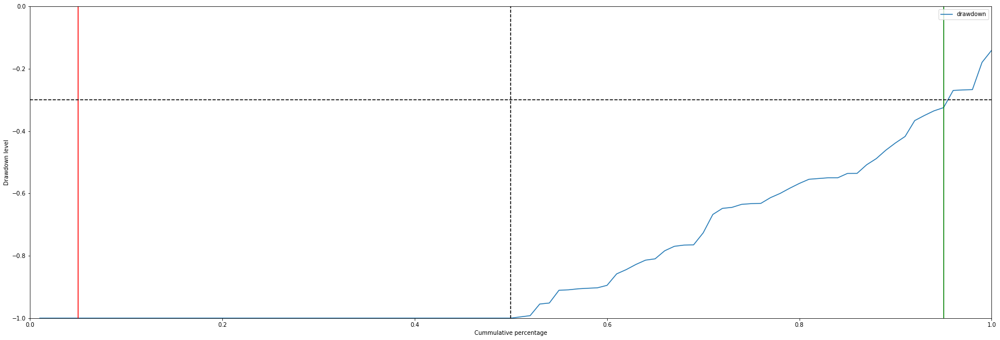

In [241]:
ax = drawdown_results.plot(x='cump_dd', y='drawdown')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(mdd_level, color='black', linestyle='--')
plt.xlabel('Cummulative percentage')
plt.ylabel('Drawdown level')
plt.xlim(0, 1)
plt.ylim(-1, 0)
plt.show()

In [242]:
percentile_5th = drawdown_results[drawdown_results.cump_dd <= percentile_below].tail(1)
percentile_95th = drawdown_results[drawdown_results.cump_dd >= percentile_above].head(1)
percentile_50th = drawdown_results.iloc[int(len(drawdown_results) / 2)]

threshold = drawdown_results[drawdown_results.drawdown <= mdd_level].tail(1)

In [243]:
print('On average MDD is expected to be {:.2f}% or greater.\n'.format(percentile_50th.drawdown * 100))
print("There's a 5% chance for MDD to be {:.2f}% or greater.\n".format(percentile_5th.drawdown.values[0] * 100))
print("There's a 95% chance for MDD to be {:.2f}% or greater.\n".format(percentile_95th.drawdown.values[0] * 100))

print('{:.2f}% of simulations had greater MDD than {:.2f}%.'.format(threshold.cump_dd.values[0] * 100, mdd_level * 100))

On average MDD is expected to be -99.61% or greater.

There's a 5% chance for MDD to be -100.00% or greater.

There's a 95% chance for MDD to be -32.47% or greater.

95.00% of simulations had greater MDD than -30.00%.


## Progressive position sizing

In this betting method the bet size is increased by 1/3 each time after our earnings are more than 3 times our current bet, when the player looses the bet size is set to the initial bet size.

In [244]:
def progressive_strategy(initial_funds, pos_size, trials):
    current_funds = initial_funds
    current_size = pos_size
    
    trades = np.array([])
    funds = np.array([])
    drawdown = np.array([], dtype=float)
    
    for single_trade in range(trials):
        if current_funds > 0:
            if successful_trade():
                current_funds += current_size
                earnings = initial_funds - current_funds

                if earnings > (3 * current_size):
                    current_size += (pos_size / 3)
                else:
                    current_size = pos_size
            else:
                current_funds -= current_size
                current_size = pos_size
            
        trades = np.append(trades, single_trade)

        # Funds to samples
        if current_funds < 0:
            current_funds = 0

        funds = np.append(funds, current_funds)
        
        # Drawdown to samples
        if current_funds > 0:
            dd = (current_funds - np.amax(funds)) / np.amax(funds)
        else:
            dd = -1

        drawdown = np.append(drawdown, np.amin([0, dd]))
    
    plt.figure(0)
    plt.plot(trades, funds)
    plt.xlabel('Trial')
    plt.ylabel('Capital')
    #plt.savefig('strategy-progressive-capital.png', bbox_inches='tight')
    
    plt.figure(1)
    plt.plot(trades, drawdown)
    plt.xlabel('Trial')
    plt.ylabel('Drawdown')
    #plt.savefig('strategy-progressive-drawdown.png', bbox_inches='tight')
    
    return (current_funds, min(drawdown))

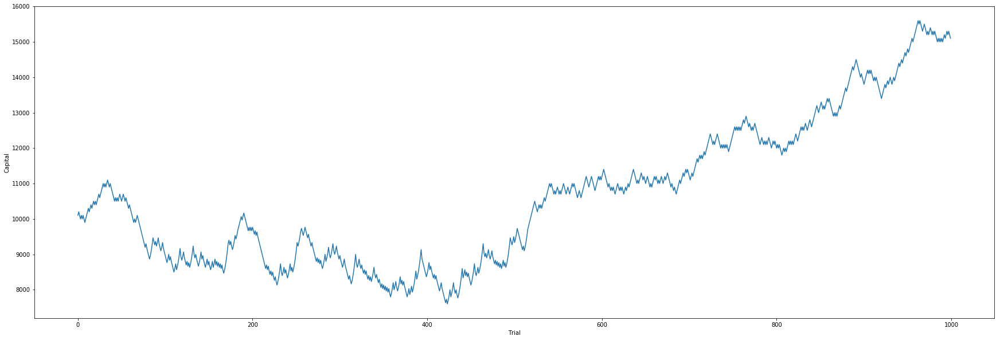

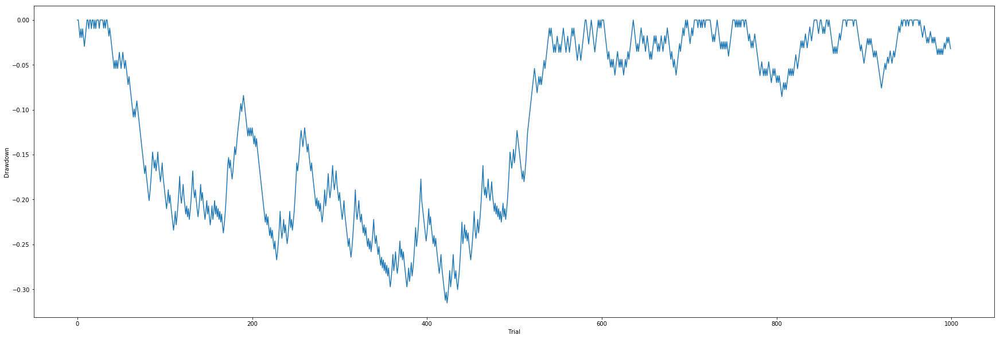

In [245]:
# Bet a 3rd of earnings on winning streaks
progressive_strategy(init_capital, 100, trials)
plt.show()

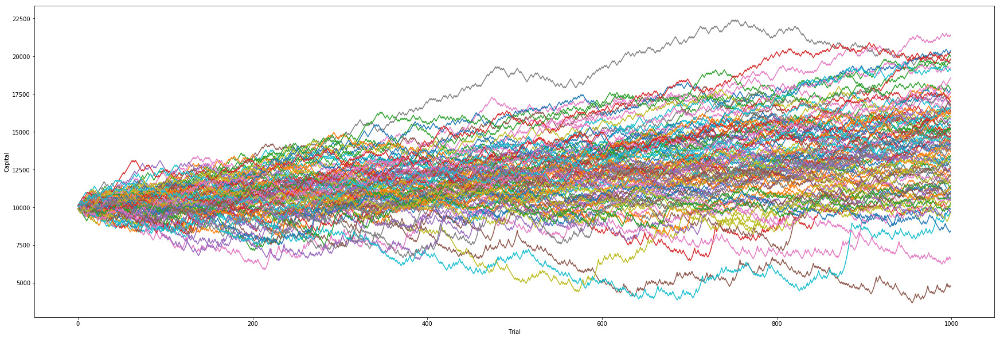

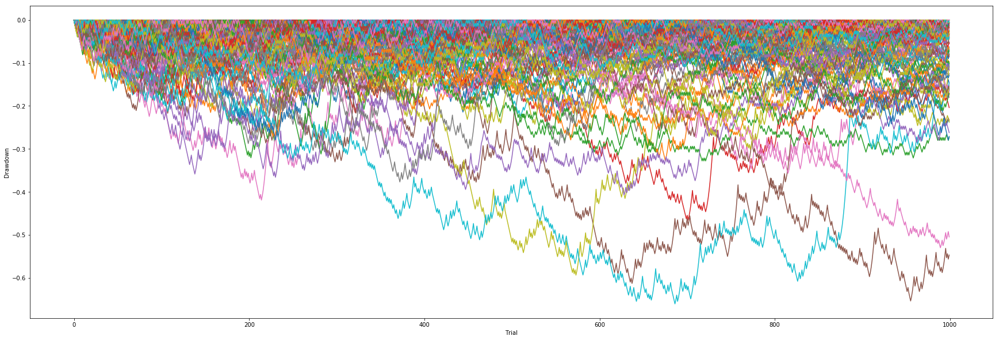

In [246]:
balances = np.array([], dtype=int)
drawdowns = np.array([], dtype=float)

for _ in range(run_times):
    run_result, run_dd = progressive_strategy(init_capital, 100, trials)
    balances = np.append(balances, run_result)
    drawdowns = np.append(drawdowns, run_dd)

plt.show()

In [247]:
progressive_results = pd.DataFrame({'balance': balances, 'drawdown': drawdowns})
percent_unit = 1 / len(progressive_results)

progressive_results['cump_balance'] = percent_unit
progressive_results['cump_dd'] = percent_unit

progressive_results['cump_balance'] = progressive_results.sort_values('balance').cump_balance.cumsum()
progressive_results['cump_dd'] = progressive_results.sort_values('drawdown').cump_dd.cumsum()

In [248]:
progressive_results.describe()

,balance,drawdown,cump_balance,cump_dd
count,100.000000,100.000000,100.000000,100.000000
mean,14140.333333,-0.225024,0.505000,0.505000
std,3160.127201,0.112810,0.290115,0.290115
min,4800.000000,-0.660819,0.010000,0.010000
25%,11858.333333,-0.264928,0.257500,0.257500
50%,14200.000000,-0.195772,0.505000,0.505000
75%,16350.000000,-0.153595,0.752500,0.752500
max,21400.000000,-0.073620,1.000000,1.000000


In [249]:
balance_results = progressive_results.sort_values('balance')
drawdown_results = progressive_results.sort_values('drawdown')

### CDF Ending Balance

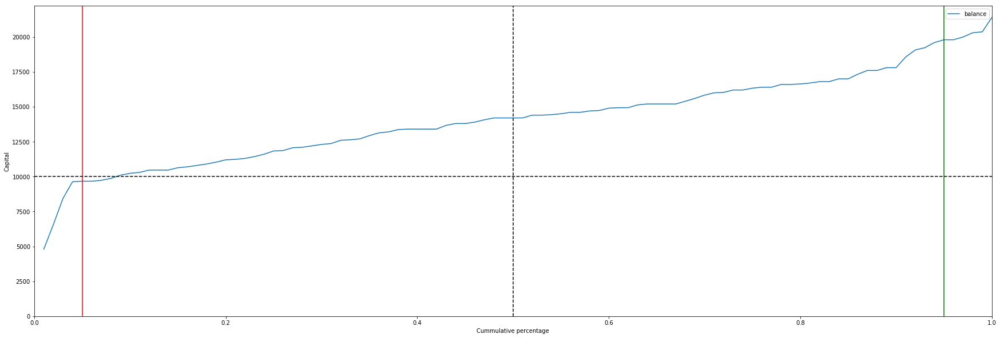

In [250]:
ax = balance_results.plot(x='cump_balance', y='balance')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(init_capital, color='black', linestyle='--')
plt.xlabel('Cummulative percentage')
plt.ylabel('Capital')
plt.xlim(0, 1)
plt.ylim(bottom=0)
plt.show()

In [251]:
percentile_5th = balance_results[balance_results.cump_balance <= percentile_below].tail(1)
percentile_95th = balance_results[balance_results.cump_balance >= percentile_above].head(1)
percentile_50th = balance_results.iloc[int(len(balance_results) / 2)]

threshold = balance_results[balance_results.balance >= init_capital].head(1)
ruin_threshold = balance_results[balance_results.balance <= ruin_capital].tail(1)

In [252]:
p5th_delta = (percentile_5th.balance.values[0] - init_capital) / init_capital
p95th_delta = (percentile_95th.balance.values[0] - init_capital) / init_capital
p50th_delta = (percentile_50th.balance - init_capital) / init_capital

In [253]:
print('On average return is expected to end at {:.2f}% or less.\n'.format(p50th_delta * 100))
print("There's a 5% chance that return ends at {:.2f}% or less.\n".format(p5th_delta * 100))
print("There's a 95% chance that return ends at {:.2f}% or less.\n".format(p95th_delta * 100))

print('{:.2f}% of simulations had capital lost.'.format(threshold.cump_balance.values[0] * 100))

if ruin_threshold.empty:
    print('  None of the simulations lost everything')
else:
    print('{:.2f}% of simulations lost everything.'.format(ruin_threshold.cump_balance.values[0] * 100))

On average return is expected to end at 42.00% or less.

There's a 5% chance that return ends at -3.33% or less.

There's a 95% chance that return ends at 98.00% or less.

9.00% of simulations had capital lost.
  None of the simulations lost everything


### CDF Maximum Drawdown

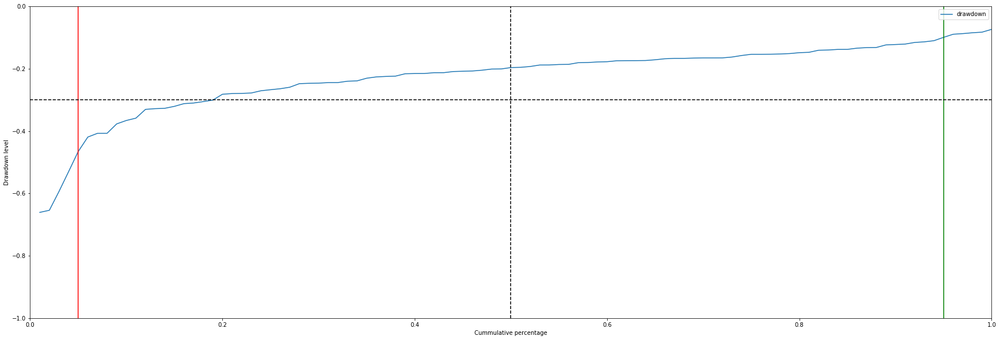

In [254]:
ax = drawdown_results.plot(x='cump_dd', y='drawdown')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(mdd_level, color='black', linestyle='--')
plt.xlabel('Cummulative percentage')
plt.ylabel('Drawdown level')
plt.xlim(0, 1)
plt.ylim(-1, 0)
plt.show()

In [255]:
percentile_5th = drawdown_results[drawdown_results.cump_dd <= percentile_below].tail(1)
percentile_95th = drawdown_results[drawdown_results.cump_dd >= percentile_above].head(1)
percentile_50th = drawdown_results.iloc[int(len(drawdown_results) / 2)]

threshold = drawdown_results[drawdown_results.drawdown <= mdd_level].tail(1)

In [256]:
print('On average MDD is expected to be {:.2f}% or greater.\n'.format(percentile_50th.drawdown * 100))
print("There's a 5% chance for MDD to be {:.2f}% or greater.\n".format(percentile_5th.drawdown.values[0] * 100))
print("There's a 95% chance for MDD to be {:.2f}% or greater.\n".format(percentile_95th.drawdown.values[0] * 100))

print('{:.2f}% of simulations had greater MDD than {:.2f}%.'.format(threshold.cump_dd.values[0] * 100, mdd_level * 100))

On average MDD is expected to be -19.54% or greater.

There's a 5% chance for MDD to be -46.56% or greater.

There's a 95% chance for MDD to be -9.92% or greater.

19.00% of simulations had greater MDD than -30.00%.


## Kelly Formula

Each time the player bets a percentage based in the probability of winning, is expressed as `f = p - q` where:

- `f = funds percentage to bet`
- `p = P(Wining)`
- `q = 1 - p`

### Static

The probability of winning never changes

In [257]:
def kelly_strategy(funds, trials):
    current_funds = funds
    q = 1 - p_winning
    
    trades = np.array([])
    funds = np.array([])
    drawdown = np.array([], dtype=float)
    
    for single_trade in range(trials):
        if current_funds > 0:
            current_size = current_funds * (p_winning - q)

            if successful_trade():
                current_funds += current_size
            else:
                current_funds -= current_size

        trades = np.append(trades, single_trade)
        
        # Funds to samples
        if current_funds < 0:
            current_funds = 0

        funds = np.append(funds, current_funds)

        # Drawdown to samples
        if current_funds > 0:
            dd = (current_funds - np.amax(funds)) / np.amax(funds)
        else:
            dd = -1

        drawdown = np.append(drawdown, np.amin([0, dd]))
        
    plt.figure(0)
    plt.plot(trades, funds)
    plt.xlabel('Trial')
    plt.ylabel('Capital')
    #plt.savefig('strategy-kelly-capital.png', bbox_inches='tight')
    
    plt.figure(1)
    plt.plot(trades, drawdown)
    plt.xlabel('Trial')
    plt.ylabel('Drawdown')
    #plt.savefig('strategy-kelly-drawdown.png', bbox_inches='tight')
    
    return (current_funds, min(drawdown))

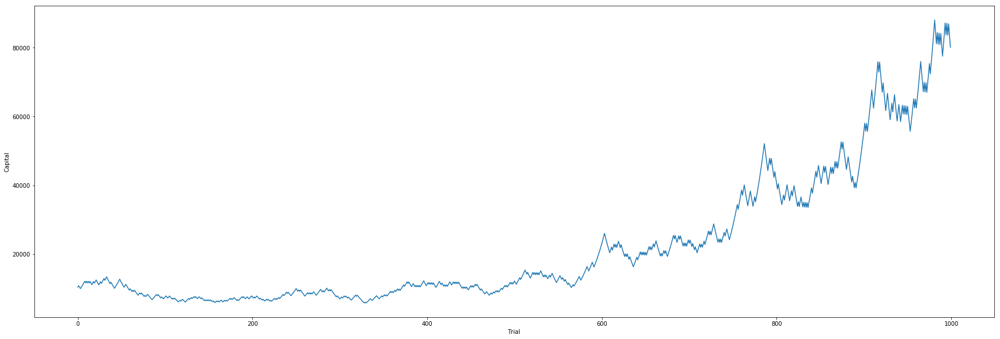

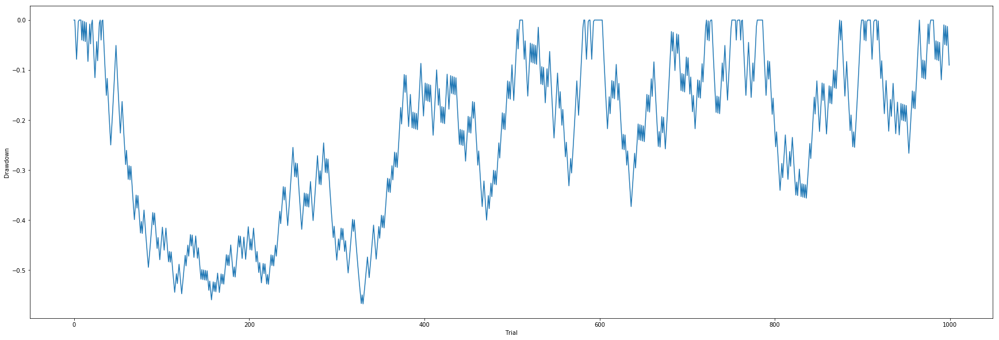

In [258]:
kelly_strategy(init_capital, trials)
plt.show()

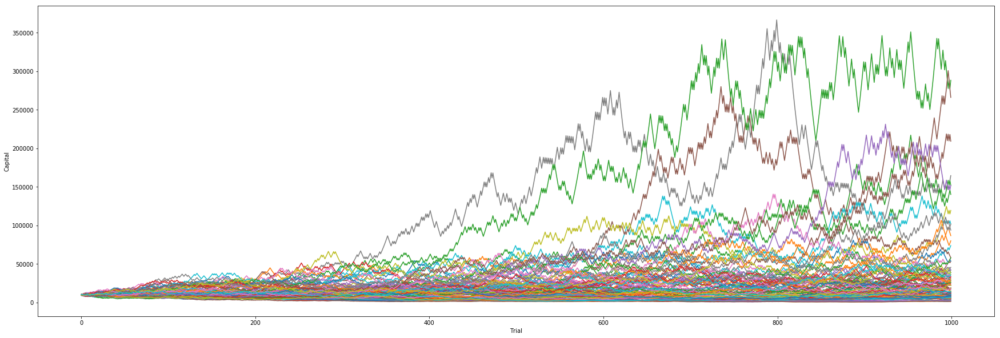

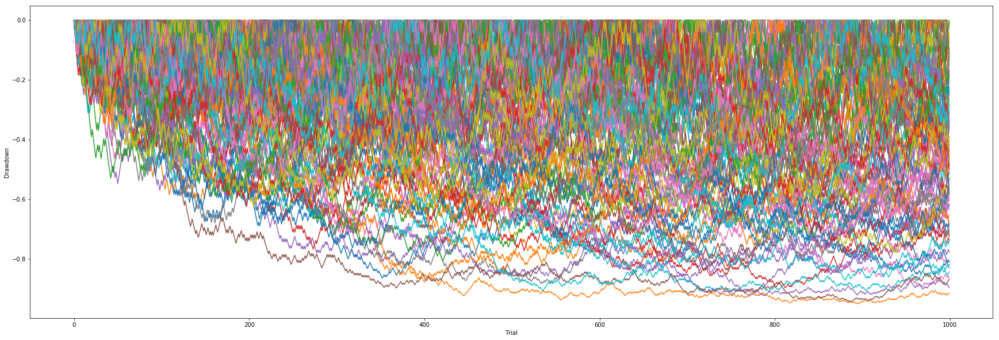

In [259]:
balances = np.array([], dtype=int)
drawdowns = np.array([], dtype=float)

for _ in range(run_times):
    run_result, run_dd = kelly_strategy(init_capital, trials)
    balances = np.append(balances, run_result)
    drawdowns = np.append(drawdowns, run_dd)
    
plt.show()

In [260]:
kelly_results = pd.DataFrame({'balance': balances, 'drawdown': drawdowns})
percent_unit = 1 / len(kelly_results)

kelly_results['cump_balance'] = percent_unit
kelly_results['cump_dd'] = percent_unit

kelly_results['cump_balance'] = kelly_results.sort_values('balance').cump_balance.cumsum()
kelly_results['cump_dd'] = kelly_results.sort_values('drawdown').cump_dd.cumsum()

In [261]:
kelly_results.describe()

,balance,drawdown,cump_balance,cump_dd
count,100.000000,100.000000,100.000000,100.000000
mean,37323.528120,-0.689817,0.505000,0.505000
std,51897.506898,0.136064,0.290115,0.290115
min,1586.276125,-0.951168,0.010000,0.010000
25%,9228.797687,-0.794300,0.257500,0.257500
50%,18967.237480,-0.691461,0.505000,0.505000
75%,36732.947201,-0.590940,0.752500,0.752500
max,288347.170859,-0.368376,1.000000,1.000000


In [262]:
balance_results = kelly_results.sort_values('balance')
drawdown_results = kelly_results.sort_values('drawdown')

### CDF Ending Balance

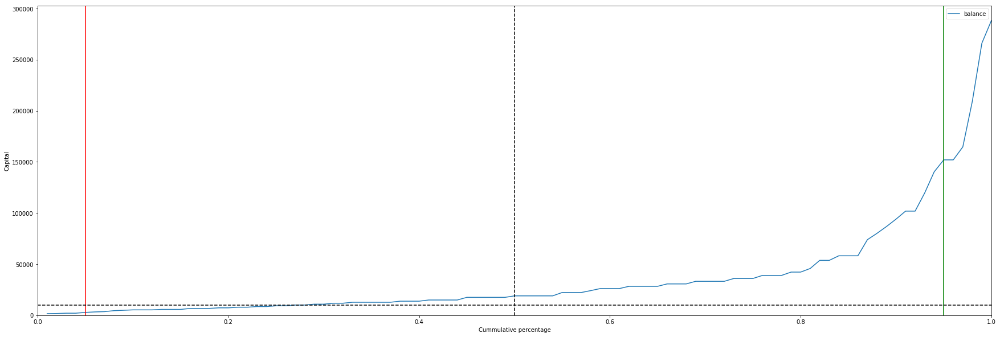

In [263]:
ax = balance_results.plot(x='cump_balance', y='balance')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(init_capital, color='black', linestyle='--')
plt.xlabel('Cummulative percentage')
plt.ylabel('Capital')
plt.xlim(0, 1)
plt.ylim(bottom=0)
plt.show()

In [264]:
percentile_5th = balance_results[balance_results.cump_balance <= percentile_below].tail(1)
percentile_95th = balance_results[balance_results.cump_balance >= percentile_above].head(1)
percentile_50th = balance_results.iloc[int(len(balance_results) / 2)]

threshold = balance_results[balance_results.balance >= init_capital].head(1)
ruin_threshold = balance_results[balance_results.balance <= ruin_capital].tail(1)

In [265]:
p5th_delta = (percentile_5th.balance.values[0] - init_capital) / init_capital
p95th_delta = (percentile_95th.balance.values[0] - init_capital) / init_capital
p50th_delta = (percentile_50th.balance - init_capital) / init_capital

In [266]:
print('On average return is expected to end at {:.2f}% or less.\n'.format(p50th_delta * 100))
print("There's a 5% chance that return ends at {:.2f}% or less.\n".format(p5th_delta * 100))
print("There's a 95% chance that return ends at {:.2f}% or less.\n".format(p95th_delta * 100))

print('{:.2f}% of simulations had capital lost.'.format(threshold.cump_balance.values[0] * 100))

if ruin_threshold.empty:
    print('  None of the simulations lost everything')
else:
    print('{:.2f}% of simulations lost everything.'.format(ruin_threshold.cump_balance.values[0] * 100))

On average return is expected to end at 89.67% or less.

There's a 5% chance that return ends at -72.22% or less.

There's a 95% chance that return ends at 1419.91% or less.

29.00% of simulations had capital lost.
  None of the simulations lost everything


### CDF Maximum Drawdown

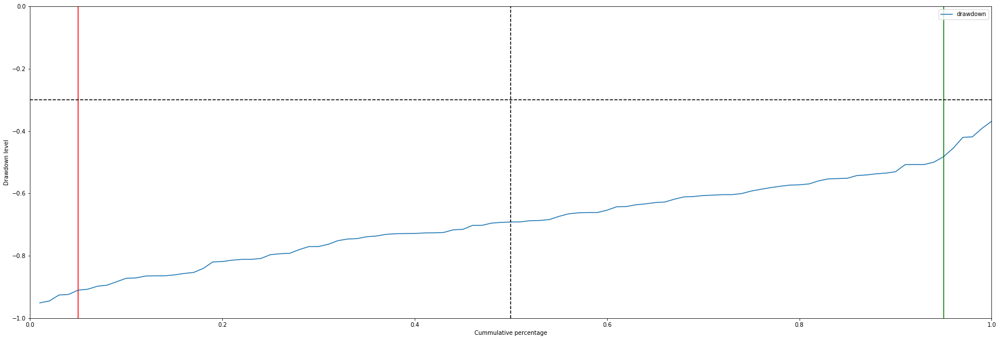

In [267]:
ax = drawdown_results.plot(x='cump_dd', y='drawdown')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(mdd_level, color='black', linestyle='--')
plt.xlabel('Cummulative percentage')
plt.ylabel('Drawdown level')
plt.xlim(0, 1)
plt.ylim(-1, 0)
plt.show()

In [268]:
percentile_5th = drawdown_results[drawdown_results.cump_dd <= percentile_below].tail(1)
percentile_95th = drawdown_results[drawdown_results.cump_dd >= percentile_above].head(1)
percentile_50th = drawdown_results.iloc[int(len(drawdown_results) / 2)]

threshold = drawdown_results[drawdown_results.drawdown <= mdd_level].tail(1)

In [269]:
print('On average MDD is expected to be {:.2f}% or greater.\n'.format(percentile_50th.drawdown * 100))
print("There's a 5% chance for MDD to be {:.2f}% or greater.\n".format(percentile_5th.drawdown.values[0] * 100))
print("There's a 95% chance for MDD to be {:.2f}% or greater.\n".format(percentile_95th.drawdown.values[0] * 100))

print('{:.2f}% of simulations had greater MDD than {:.2f}%.'.format(threshold.cump_dd.values[0] * 100, mdd_level * 100))

On average MDD is expected to be -69.12% or greater.

There's a 5% chance for MDD to be -91.03% or greater.

There's a 95% chance for MDD to be -48.21% or greater.

100.00% of simulations had greater MDD than -30.00%.


### Dynamic

The probability of winning varies between X and Y.

In [270]:
def kelly_strategy_dynamic(initial_funds, trials):
    current_funds = initial_funds
    
    trades = np.array([])
    funds = np.array([])
    drawdown = np.array([], dtype=float)
    
    for single_trade in range(trials):
        if current_funds > 0:
            chance_winning = np.random.normal(52, 4)  # With mean = 55, std = 5, 94% of the times the player wins 
            chance_loosing = 100 - chance_winning

            percent_size = abs(chance_winning - chance_loosing) / 100
            current_size = math.floor(current_funds * percent_size)

            if successful_trade(p=(chance_winning / 100)):
                current_funds += current_size
            else:
                current_funds -= current_size

        trades = np.append(trades, single_trade)

        # Funds to samples
        if current_funds < 0:
            current_funds = 0

        funds = np.append(funds, current_funds)

        # Drawdown to samples
        if current_funds > 0:
            dd = (current_funds - np.amax(funds)) / np.amax(funds)
        else:
            dd = -1

        drawdown = np.append(drawdown, np.amin([0, dd]))
            
    plt.figure(0)
    plt.plot(trades, funds)
    plt.xlabel('Trial')
    plt.ylabel('Capital')
    
    plt.figure(1)
    plt.plot(trades, drawdown)
    plt.xlabel('Trial')
    plt.ylabel('Drawdown')
    
    return (current_funds, min(drawdown))

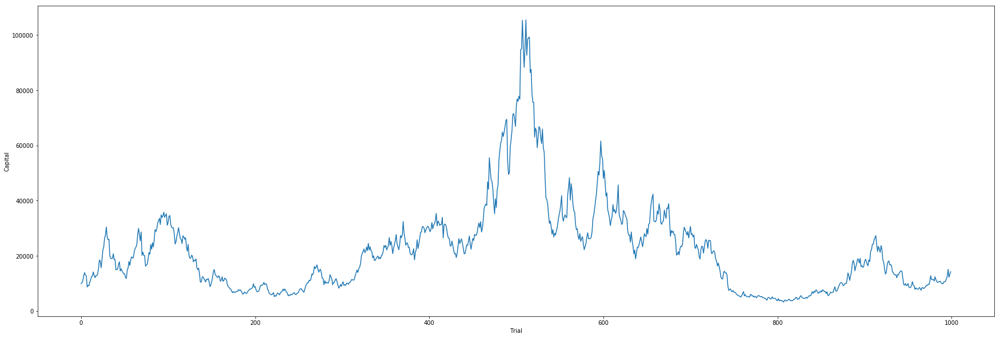

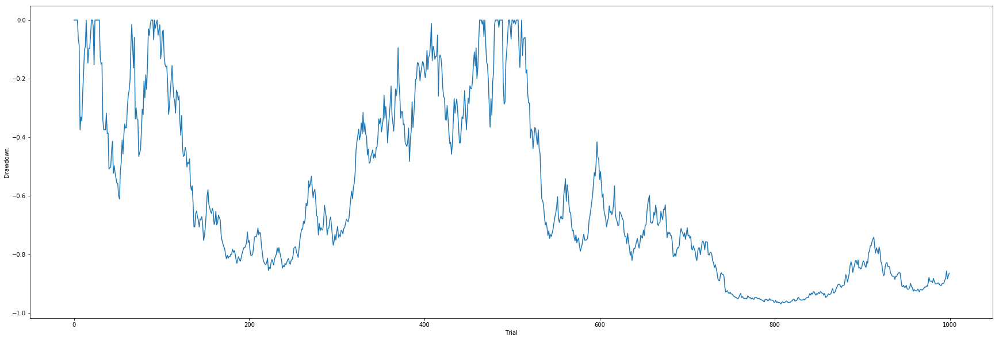

In [271]:
kelly_strategy_dynamic(init_capital, trials)
plt.show()

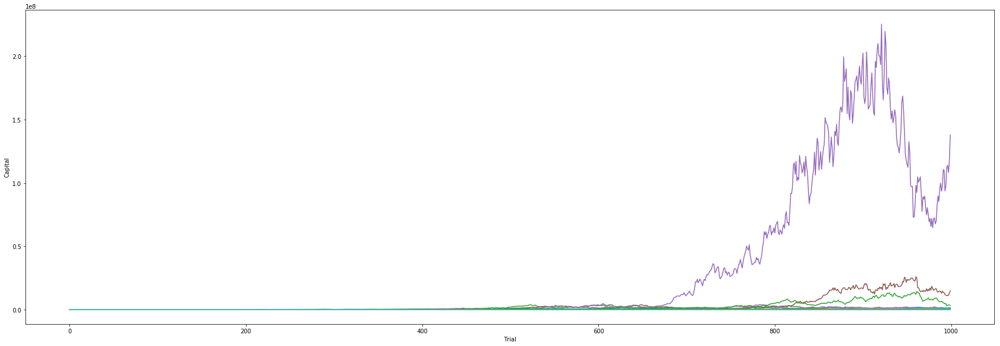

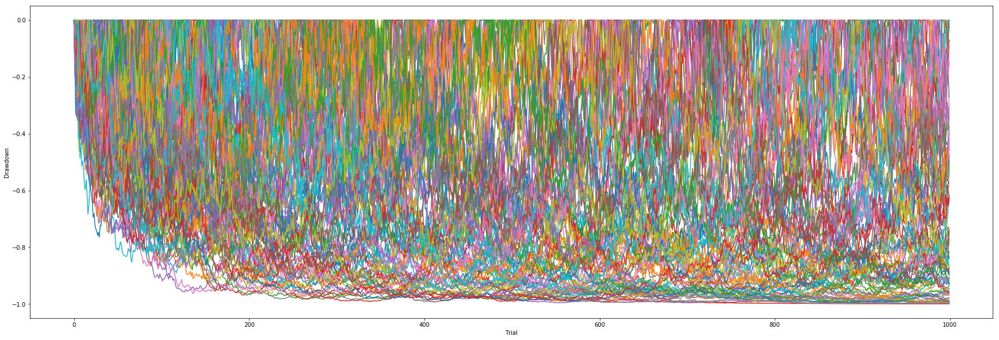

In [272]:
balances = np.array([], dtype=int)
drawdowns = np.array([], dtype=float)

for _ in range(run_times):
    run_result, run_dd = kelly_strategy_dynamic(init_capital, trials)
    balances = np.append(balances, run_result)
    drawdowns = np.append(drawdowns, run_dd)

plt.show()

In [273]:
kellyd_results = pd.DataFrame({'balance': balances, 'drawdown': drawdowns})
percent_unit = 1 / len(kellyd_results)

kellyd_results['cump_balance'] = percent_unit
kellyd_results['cump_dd'] = percent_unit

kellyd_results['cump_balance'] = kellyd_results.sort_values('balance').cump_balance.cumsum()
kellyd_results['cump_dd'] = kellyd_results.sort_values('drawdown').cump_dd.cumsum()

In [274]:
kellyd_results.describe()

,balance,drawdown,cump_balance,cump_dd
count,1.000000e+02,100.000000,100.000000,100.000000
mean,1.696315e+06,-0.937033,0.505000,0.505000
std,1.385405e+07,0.069804,0.290115,0.290115
min,8.000000e+00,-0.999621,0.010000,0.010000
25%,2.266000e+03,-0.984497,0.257500,0.257500
50%,1.221600e+04,-0.958656,0.505000,0.505000
75%,6.800600e+04,-0.922937,0.752500,0.752500
max,1.379919e+08,-0.699007,1.000000,1.000000


In [275]:
balance_results = kellyd_results.sort_values('balance')
drawdown_results = kellyd_results.sort_values('drawdown')

### CDF Ending Balance

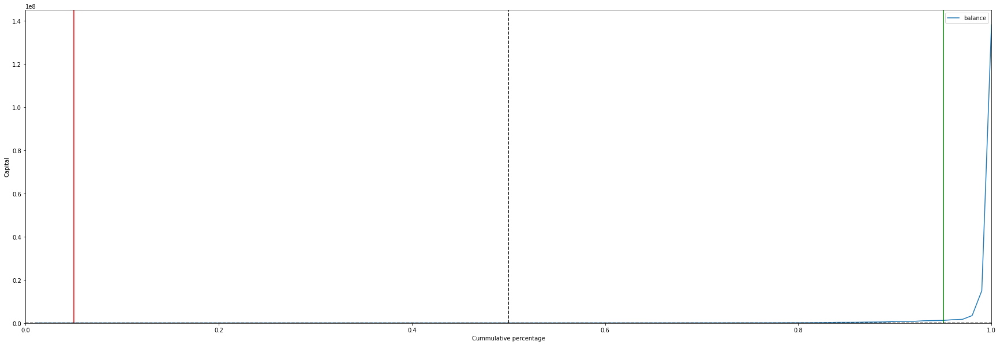

In [276]:
ax = balance_results.plot(x='cump_balance', y='balance')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(init_capital, color='black', linestyle='--')
plt.xlabel('Cummulative percentage')
plt.ylabel('Capital')
plt.xlim(0, 1)
plt.ylim(bottom=0)
plt.show()

In [277]:
percentile_5th = balance_results[balance_results.cump_balance <= percentile_below].tail(1)
percentile_95th = balance_results[balance_results.cump_balance >= percentile_above].head(1)
percentile_50th = balance_results.iloc[int(len(balance_results) / 2)]

threshold = balance_results[balance_results.balance >= init_capital].head(1)
ruin_threshold = balance_results[balance_results.balance <= ruin_capital].tail(1)

In [278]:
p5th_delta = (percentile_5th.balance.values[0] - init_capital) / init_capital
p95th_delta = (percentile_95th.balance.values[0] - init_capital) / init_capital
p50th_delta = (percentile_50th.balance - init_capital) / init_capital

In [279]:
print('On average return is expected to end at {:.2f}% or less.\n'.format(p50th_delta * 100))
print("There's a 5% chance that return ends at {:.2f}% or less.\n".format(p5th_delta * 100))
print("There's a 95% chance that return ends at {:.2f}% or less.\n".format(p95th_delta * 100))

print('{:.2f}% of simulations had capital lost.'.format(threshold.cump_balance.values[0] * 100))

if ruin_threshold.empty:
    print('  None of the simulations lost everything')
else:
    print('{:.2f}% of simulations lost everything.'.format(ruin_threshold.cump_balance.values[0] * 100))

On average return is expected to end at 22.66% or less.

There's a 5% chance that return ends at -98.74% or less.

There's a 95% chance that return ends at 11842.33% or less.

48.00% of simulations had capital lost.
  None of the simulations lost everything


### CDF Maximum Drawdown

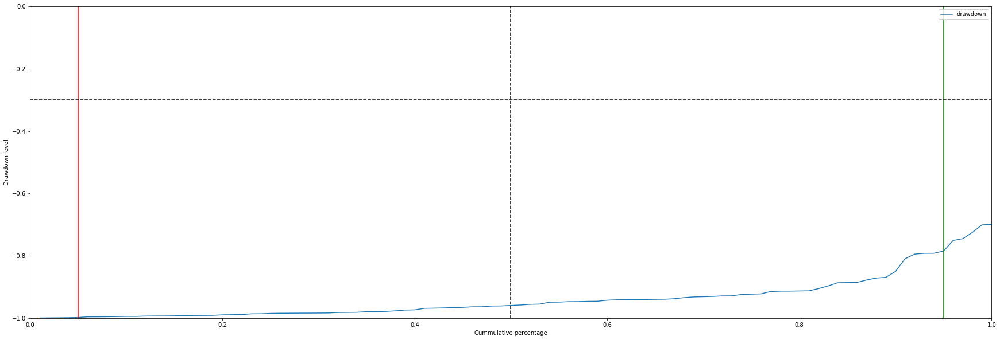

In [280]:
ax = drawdown_results.plot(x='cump_dd', y='drawdown')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(mdd_level, color='black', linestyle='--')
plt.xlabel('Cummulative percentage')
plt.ylabel('Drawdown level')
plt.xlim(0, 1)
plt.ylim(-1, 0)
plt.show()

In [281]:
percentile_5th = drawdown_results[drawdown_results.cump_dd <= percentile_below].tail(1)
percentile_95th = drawdown_results[drawdown_results.cump_dd >= percentile_above].head(1)
percentile_50th = drawdown_results.iloc[int(len(drawdown_results) / 2)]

threshold = drawdown_results[drawdown_results.drawdown <= mdd_level].tail(1)

In [282]:
print('On average MDD is expected to be {:.2f}% or greater.\n'.format(percentile_50th.drawdown * 100))
print("There's a 5% chance for MDD to be {:.2f}% or greater.\n".format(percentile_5th.drawdown.values[0] * 100))
print("There's a 95% chance for MDD to be {:.2f}% or greater.\n".format(percentile_95th.drawdown.values[0] * 100))

print('{:.2f}% of simulations had greater MDD than {:.2f}%.'.format(threshold.cump_dd.values[0] * 100, mdd_level * 100))

On average MDD is expected to be -95.80% or greater.

There's a 5% chance for MDD to be -99.78% or greater.

There's a 95% chance for MDD to be -78.49% or greater.

100.00% of simulations had greater MDD than -30.00%.


## D'Alembert position sizing

Each time the player looses the bet is increased by some fixed amount, when the player wins the bet size is reduced by the same amount.

In [283]:
def dalembert_strategy(initial_funds, pos_size, trials, increase_on_win=False, increase_by=1):
    current_funds = initial_funds
    current_size = pos_size
    
    delta = pos_size * increase_by
    
    trades = np.array([])
    funds = np.array([])
    drawdown = np.array([], dtype=float)
    
    for single_trade in range(trials):
        if current_funds > 0:
            if successful_trade():
                current_funds += current_size

                if increase_on_win:
                    current_size += delta
                else:
                    current_size -= delta
            else:
                current_funds -= current_size

                if increase_on_win:
                    current_size -= delta
                else:
                    current_size += delta

        trades = np.append(trades, single_trade)
        
        # Funds to samples
        if current_funds < 0:
            current_funds = 0

        funds = np.append(funds, current_funds)
        
        # Drawdown to samples
        if current_funds > 0:
            dd = (current_funds - np.amax(funds)) / np.amax(funds)
        else:
            dd = -1

        drawdown = np.append(drawdown, np.amin([0, dd]))
            
    plt.figure(0)
    plt.plot(trades, funds)
    plt.xlabel('Trial')
    plt.ylabel('Capital')
    #plt.savefig('strategy-dalembert-capital.png', bbox_inches='tight')
    
    plt.figure(1)
    plt.plot(trades, drawdown)
    plt.xlabel('Trial')
    plt.ylabel('Drawdown')
    #plt.savefig('strategy-dalembert-drawdown.png', bbox_inches='tight')
    
    return (current_funds, min(drawdown))

### Increase or decrease by 10% of the initial bet amount

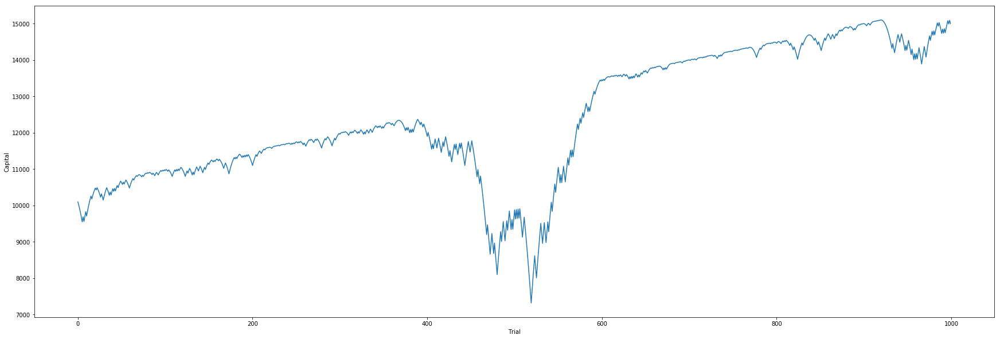

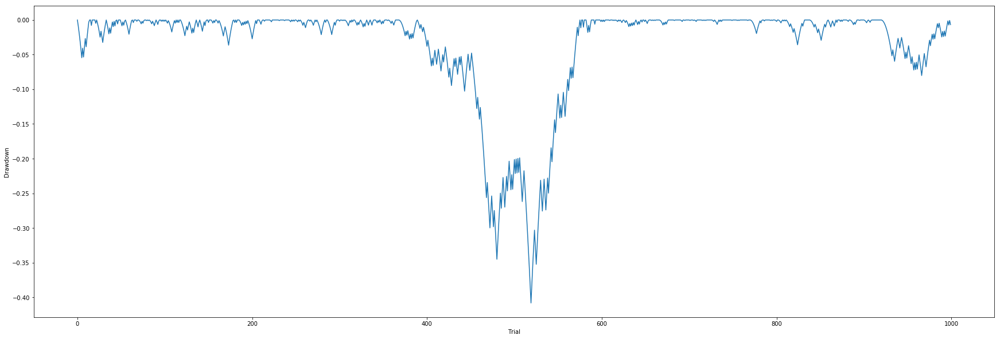

In [284]:
dalembert_strategy(init_capital, 100, trials, increase_by=.10)
plt.show()

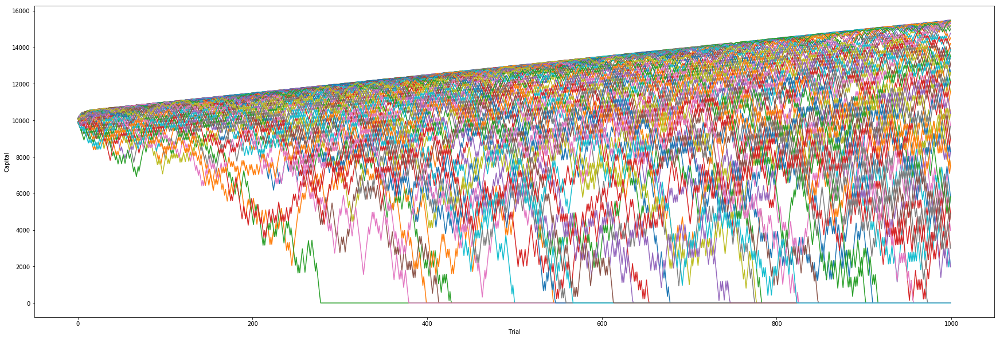

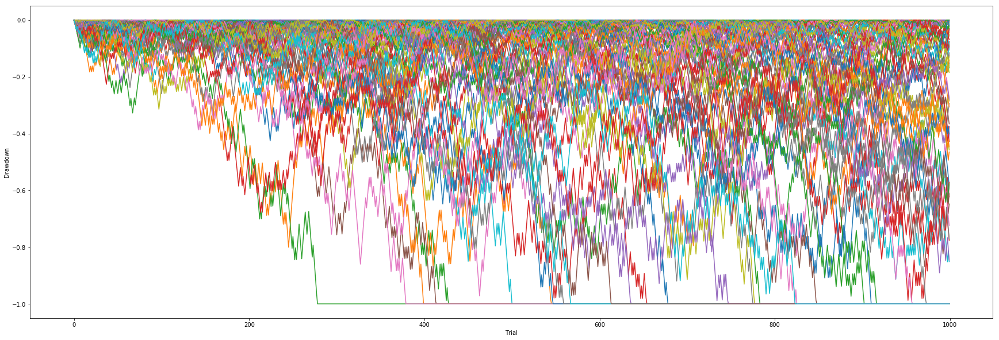

In [285]:
balances = np.array([], dtype=int)
drawdowns = np.array([], dtype=float)

for _ in range(run_times):
    run_result, run_dd = dalembert_strategy(init_capital, 100, trials, increase_by=.10)
    balances = np.append(balances, run_result)
    drawdowns = np.append(drawdowns, run_dd)

plt.show()

In [286]:
dalembert_results = pd.DataFrame({'balance': balances, 'drawdown': drawdowns})
percent_unit = 1 / len(dalembert_results)

dalembert_results['cump_balance'] = percent_unit
dalembert_results['cump_dd'] = percent_unit

dalembert_results['cump_balance'] = dalembert_results.sort_values('balance').cump_balance.cumsum()
dalembert_results['cump_dd'] = dalembert_results.sort_values('drawdown').cump_dd.cumsum()

In [287]:
dalembert_results.describe()

,balance,drawdown,cump_balance,cump_dd
count,100.000000,100.000000,100.000000,100.000000
mean,8396.800000,-0.586919,0.505000,0.505000
std,6080.703521,0.327320,0.290115,0.290115
min,0.000000,-1.000000,0.010000,0.010000
25%,0.000000,-1.000000,0.257500,0.257500
50%,10050.000000,-0.575332,0.505000,0.505000
75%,13880.000000,-0.278393,0.752500,0.752500
max,15500.000000,-0.055811,1.000000,1.000000


In [288]:
balance_results = dalembert_results.sort_values('balance')
drawdown_results = dalembert_results.sort_values('drawdown')

### CDF Ending Balance

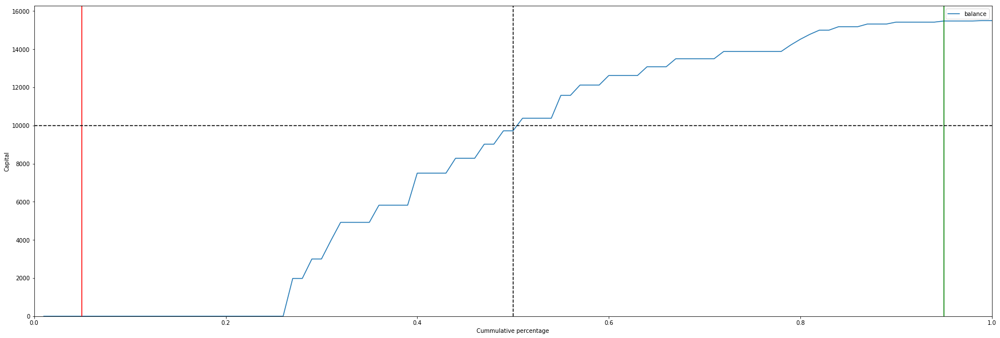

In [289]:
ax = balance_results.plot(x='cump_balance', y='balance')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(init_capital, color='black', linestyle='--')
plt.xlabel('Cummulative percentage')
plt.ylabel('Capital')
plt.xlim(0, 1)
plt.ylim(bottom=0)
plt.show()

In [290]:
percentile_5th = balance_results[balance_results.cump_balance <= percentile_below].tail(1)
percentile_95th = balance_results[balance_results.cump_balance >= percentile_above].head(1)
percentile_50th = balance_results.iloc[int(len(balance_results) / 2)]

threshold = balance_results[balance_results.balance >= init_capital].head(1)
ruin_threshold = balance_results[balance_results.balance <= ruin_capital].tail(1)

In [291]:
p5th_delta = (percentile_5th.balance.values[0] - init_capital) / init_capital
p95th_delta = (percentile_95th.balance.values[0] - init_capital) / init_capital
p50th_delta = (percentile_50th.balance - init_capital) / init_capital

In [292]:
print('On average return is expected to end at {:.2f}% or less.\n'.format(p50th_delta * 100))
print("There's a 5% chance that return ends at {:.2f}% or less.\n".format(p5th_delta * 100))
print("There's a 95% chance that return ends at {:.2f}% or less.\n".format(p95th_delta * 100))

print('{:.2f}% of simulations had capital lost.'.format(threshold.cump_balance.values[0] * 100))

if ruin_threshold.empty:
    print('  None of the simulations lost everything')
else:
    print('{:.2f}% of simulations lost everything.'.format(ruin_threshold.cump_balance.values[0] * 100))

On average return is expected to end at 3.80% or less.

There's a 5% chance that return ends at -100.00% or less.

There's a 95% chance that return ends at 54.80% or less.

51.00% of simulations had capital lost.
26.00% of simulations lost everything.


### CDF Maximum Drawdown

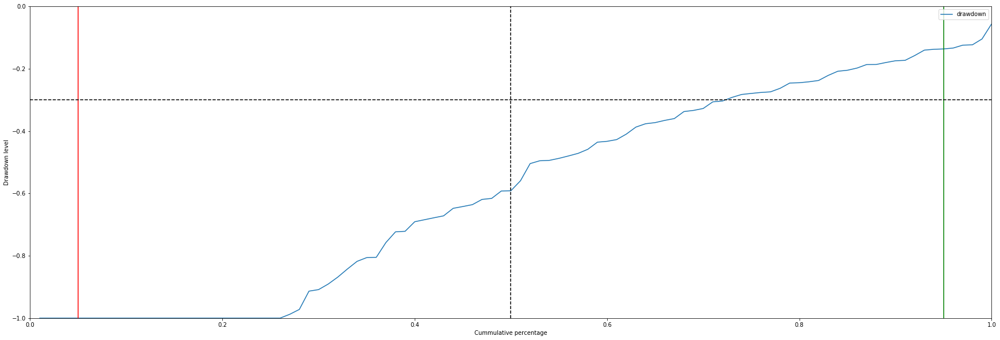

In [293]:
ax = drawdown_results.plot(x='cump_dd', y='drawdown')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(mdd_level, color='black', linestyle='--')
plt.xlabel('Cummulative percentage')
plt.ylabel('Drawdown level')
plt.xlim(0, 1)
plt.ylim(-1, 0)
plt.show()

In [294]:
percentile_5th = drawdown_results[drawdown_results.cump_dd <= percentile_below].tail(1)
percentile_95th = drawdown_results[drawdown_results.cump_dd >= percentile_above].head(1)
percentile_50th = drawdown_results.iloc[int(len(drawdown_results) / 2)]

threshold = drawdown_results[drawdown_results.drawdown <= mdd_level].tail(1)

In [295]:
print('On average MDD is expected to be {:.2f}% or greater.\n'.format(percentile_50th.drawdown * 100))
print("There's a 5% chance for MDD to be {:.2f}% or greater.\n".format(percentile_5th.drawdown.values[0] * 100))
print("There's a 95% chance for MDD to be {:.2f}% or greater.\n".format(percentile_95th.drawdown.values[0] * 100))

print('{:.2f}% of simulations had greater MDD than {:.2f}%.'.format(threshold.cump_dd.values[0] * 100, mdd_level * 100))

On average MDD is expected to be -55.93% or greater.

There's a 5% chance for MDD to be -100.00% or greater.

There's a 95% chance for MDD to be -13.64% or greater.

72.00% of simulations had greater MDD than -30.00%.


### Inverse D'Alembert

Now when loosing we decrease by 10% of the initial bet size, and when winning we increase by that same amount.

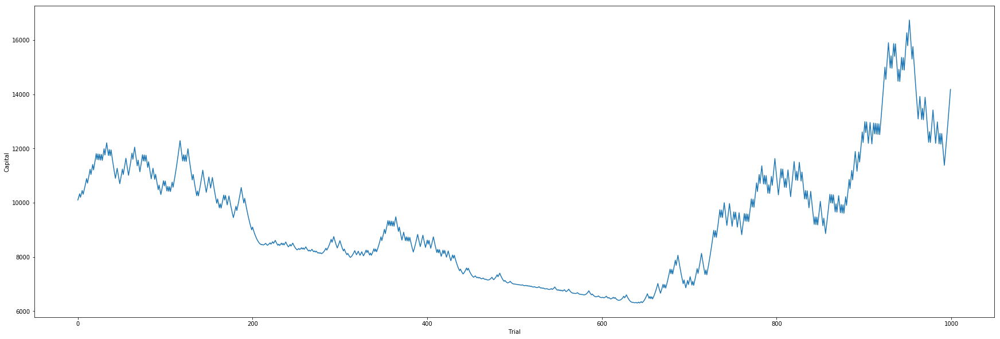

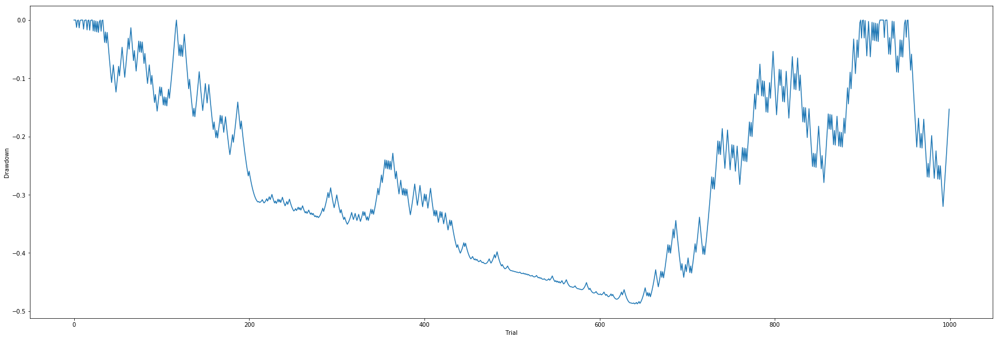

In [296]:
dalembert_strategy(init_capital, 100, trials, increase_by=.10, increase_on_win=True)
plt.show()

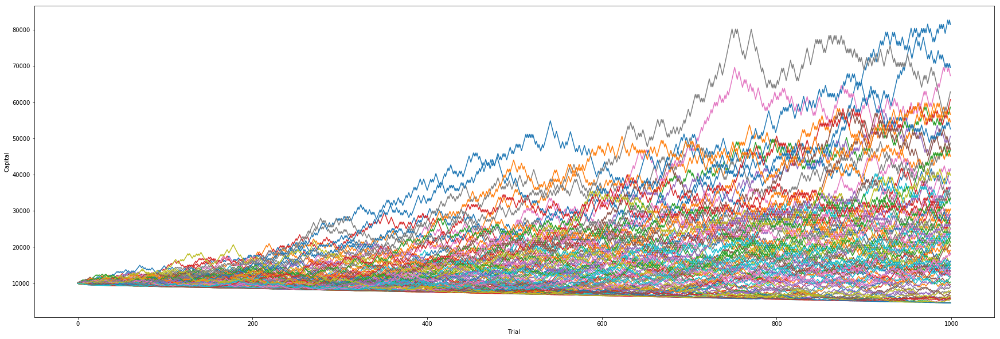

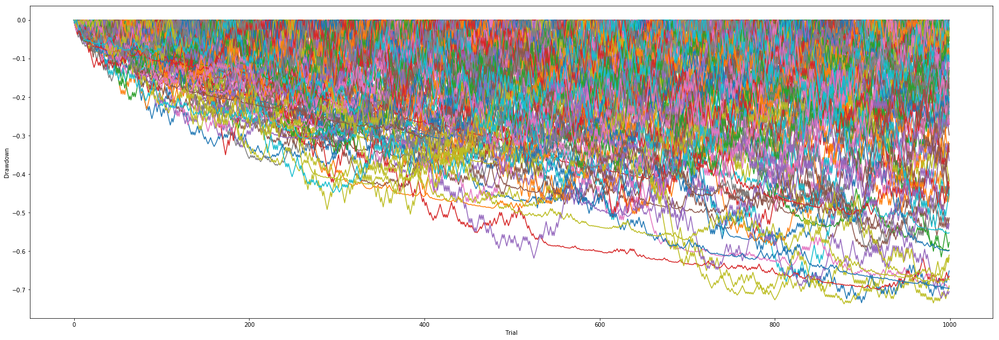

In [297]:
balances = np.array([], dtype=int)
drawdowns = np.array([], dtype=float)

for _ in range(run_times):
    run_result, run_dd = dalembert_strategy(init_capital, 100, trials, increase_by=.10, increase_on_win=True)
    balances = np.append(balances, run_result)
    drawdowns = np.append(drawdowns, run_dd)

plt.show()

In [298]:
dalembertip_results = pd.DataFrame({'balance': balances, 'drawdown': drawdowns})
percent_unit = 1 / len(dalembertip_results)

dalembertip_results['cump_balance'] = percent_unit
dalembertip_results['cump_dd'] = percent_unit

dalembertip_results['cump_balance'] = dalembertip_results.sort_values('balance').cump_balance.cumsum()
dalembertip_results['cump_dd'] = dalembertip_results.sort_values('drawdown').cump_dd.cumsum()

In [299]:
dalembertip_results.describe()

,balance,drawdown,cump_balance,cump_dd
count,100.00000,100.000000,100.000000,100.000000
mean,24440.80000,-0.449879,0.505000,0.505000
std,17010.52744,0.128539,0.290115,0.290115
min,4500.00000,-0.737021,0.010000,0.010000
25%,12305.00000,-0.523807,0.257500,0.257500
50%,21320.00000,-0.425669,0.505000,0.505000
75%,33380.00000,-0.350111,0.752500,0.752500
max,81380.00000,-0.257120,1.000000,1.000000


In [300]:
balance_results = dalembertip_results.sort_values('balance')
drawdown_results = dalembertip_results.sort_values('drawdown')

### CDF Ending Balance

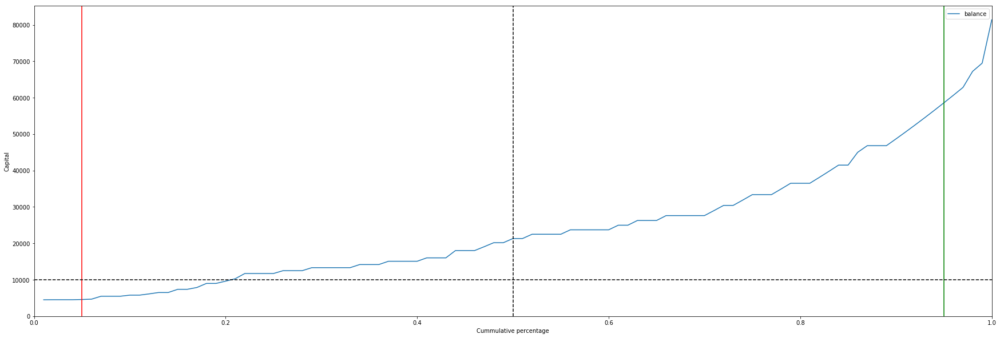

In [301]:
ax = balance_results.plot(x='cump_balance', y='balance')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(init_capital, color='black', linestyle='--')
plt.xlabel('Cummulative percentage')
plt.ylabel('Capital')
plt.xlim(0, 1)
plt.ylim(bottom=0)
plt.show()

In [302]:
percentile_5th = balance_results[balance_results.cump_balance <= percentile_below].tail(1)
percentile_95th = balance_results[balance_results.cump_balance >= percentile_above].head(1)
percentile_50th = balance_results.iloc[int(len(balance_results) / 2)]

threshold = balance_results[balance_results.balance >= init_capital].head(1)
ruin_threshold = balance_results[balance_results.balance <= ruin_capital].tail(1)

In [303]:
p5th_delta = (percentile_5th.balance.values[0] - init_capital) / init_capital
p95th_delta = (percentile_95th.balance.values[0] - init_capital) / init_capital
p50th_delta = (percentile_50th.balance - init_capital) / init_capital

In [304]:
print('On average return is expected to end at {:.2f}% or less.\n'.format(p50th_delta * 100))
print("There's a 5% chance that return ends at {:.2f}% or less.\n".format(p5th_delta * 100))
print("There's a 95% chance that return ends at {:.2f}% or less.\n".format(p95th_delta * 100))

print('{:.2f}% of simulations had capital lost.'.format(threshold.cump_balance.values[0] * 100))

if ruin_threshold.empty:
    print('  None of the simulations lost everything')
else:
    print('{:.2f}% of simulations lost everything.'.format(ruin_threshold.cump_balance.values[0] * 100))

On average return is expected to end at 113.20% or less.

There's a 5% chance that return ends at -54.20% or less.

There's a 95% chance that return ends at 485.80% or less.

21.00% of simulations had capital lost.
  None of the simulations lost everything


### CDF Maximum Drawdown

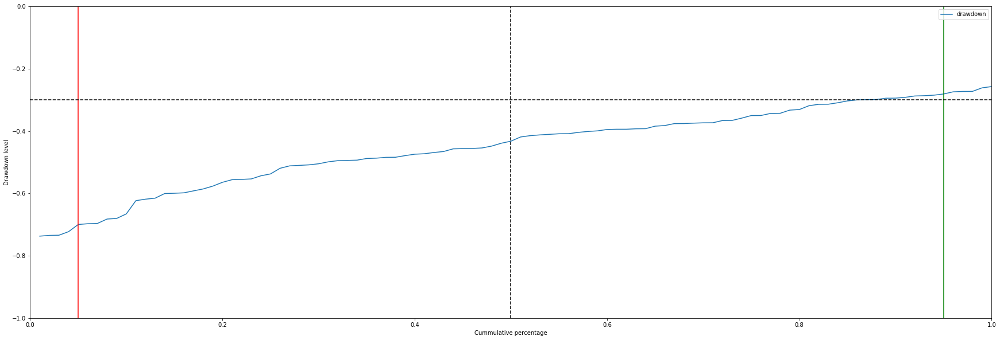

In [305]:
ax = drawdown_results.plot(x='cump_dd', y='drawdown')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(mdd_level, color='black', linestyle='--')
plt.xlabel('Cummulative percentage')
plt.ylabel('Drawdown level')
plt.xlim(0, 1)
plt.ylim(-1, 0)
plt.show()

In [306]:
percentile_5th = drawdown_results[drawdown_results.cump_dd <= percentile_below].tail(1)
percentile_95th = drawdown_results[drawdown_results.cump_dd >= percentile_above].head(1)
percentile_50th = drawdown_results.iloc[int(len(drawdown_results) / 2)]

threshold = drawdown_results[drawdown_results.drawdown <= mdd_level].tail(1)

In [307]:
print('On average MDD is expected to be {:.2f}% or greater.\n'.format(percentile_50th.drawdown * 100))
print("There's a 5% chance for MDD to be {:.2f}% or greater.\n".format(percentile_5th.drawdown.values[0] * 100))
print("There's a 95% chance for MDD to be {:.2f}% or greater.\n".format(percentile_95th.drawdown.values[0] * 100))

print('{:.2f}% of simulations had greater MDD than {:.2f}%.'.format(threshold.cump_dd.values[0] * 100, mdd_level * 100))

On average MDD is expected to be -41.89% or greater.

There's a 5% chance for MDD to be -69.97% or greater.

There's a 95% chance for MDD to be -28.09% or greater.

85.00% of simulations had greater MDD than -30.00%.
